In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
import scanpy as sc
import seaborn as sns
import anndata as ad
import pickle
import os

/mnt/c/Users/Eric Sun/Desktop/RESEARCH/GeneImputation/main.py:65: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  spatial_adata = ad.AnnData(X=df)
/home/edsun/anaconda3/envs/geneimputation/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/edsun/anaconda3/envs/geneimputation/lib/python3.8/site-packages/anndata/_core/anndata.py:872: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer

  names = self._prep_dim_index(names, "obs")
/mnt/c/Users/Eric Sun/Desktop/RESEARCH/GeneImputation/main.py:65: FutureWarning: X.dtype being converted to np.float32 from int64. In the next v

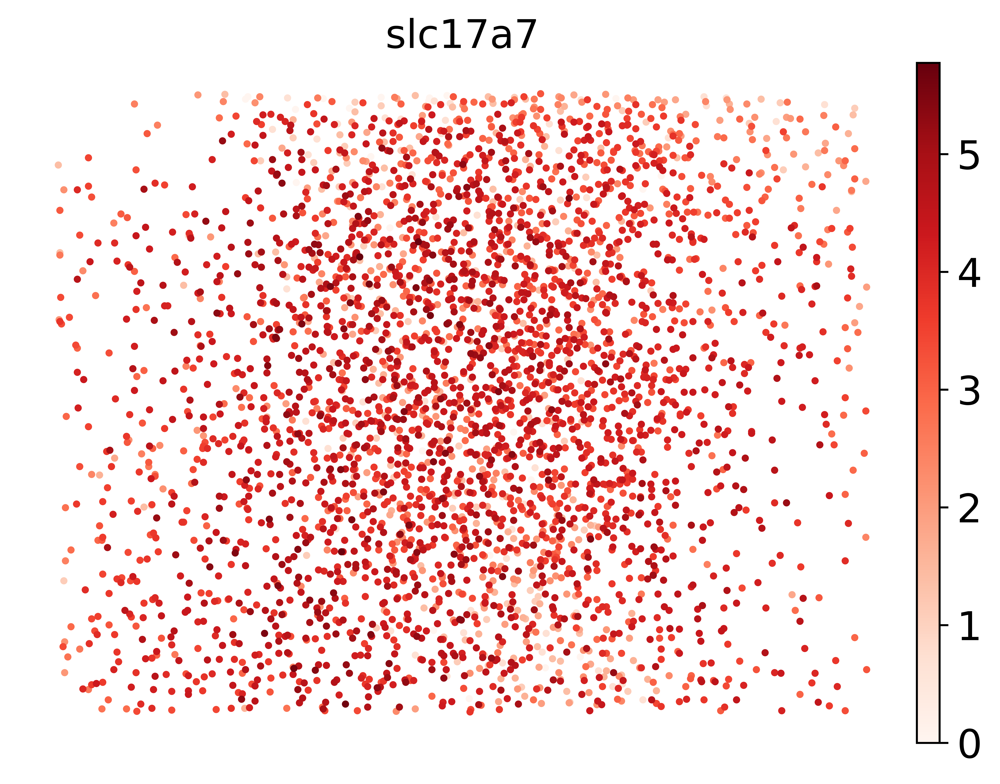

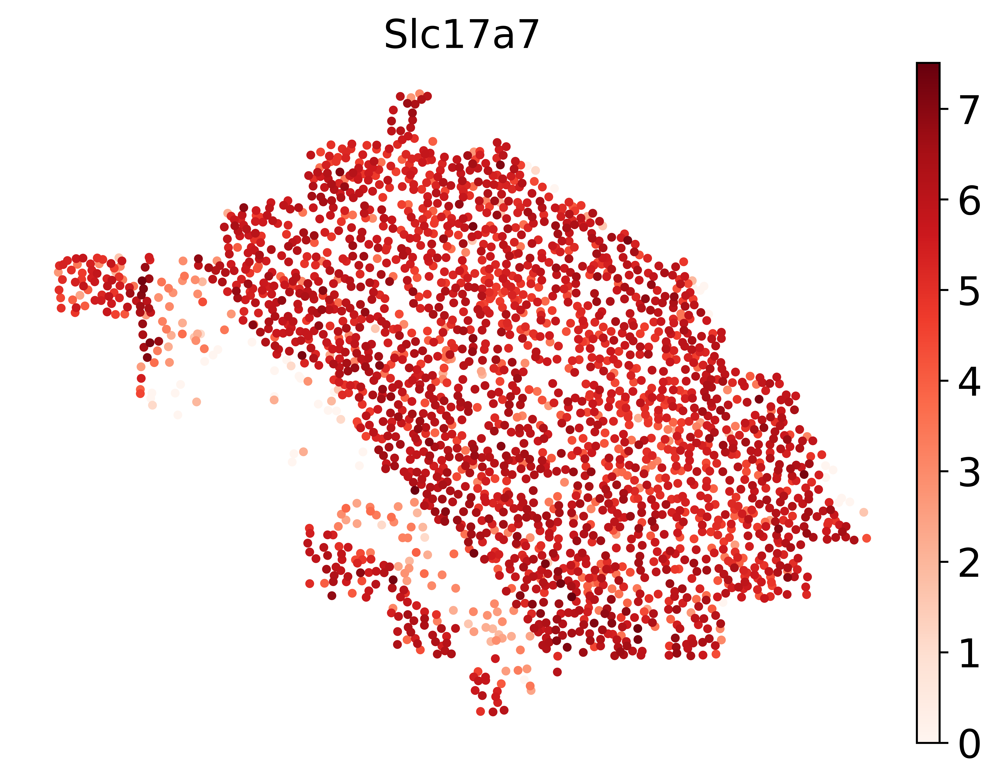

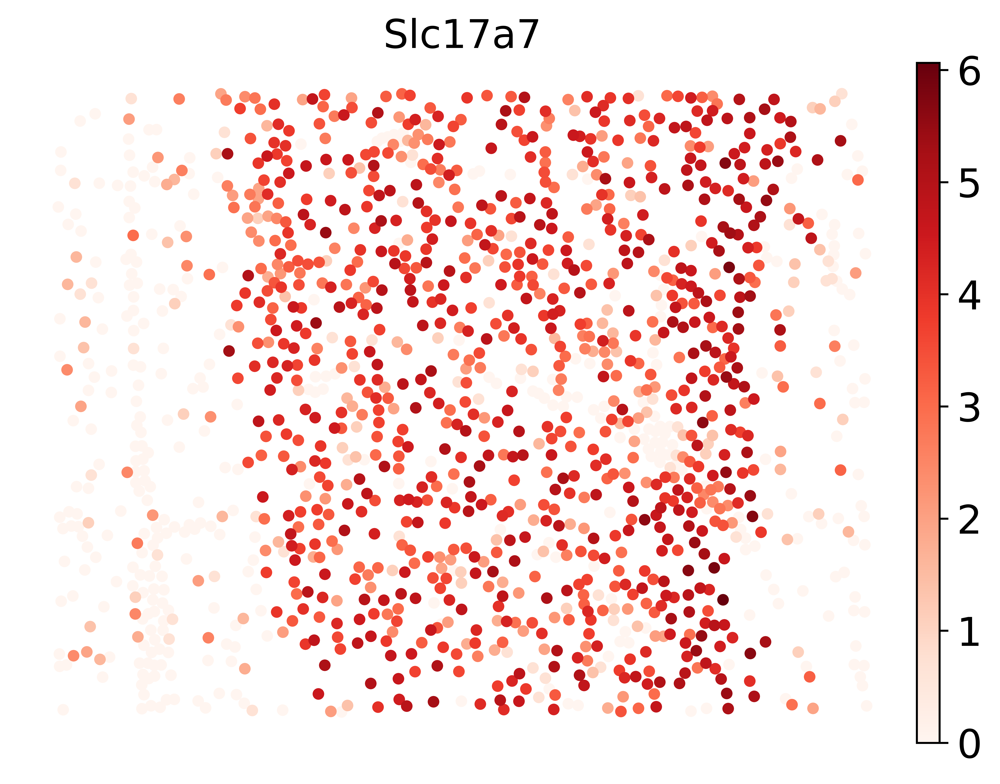

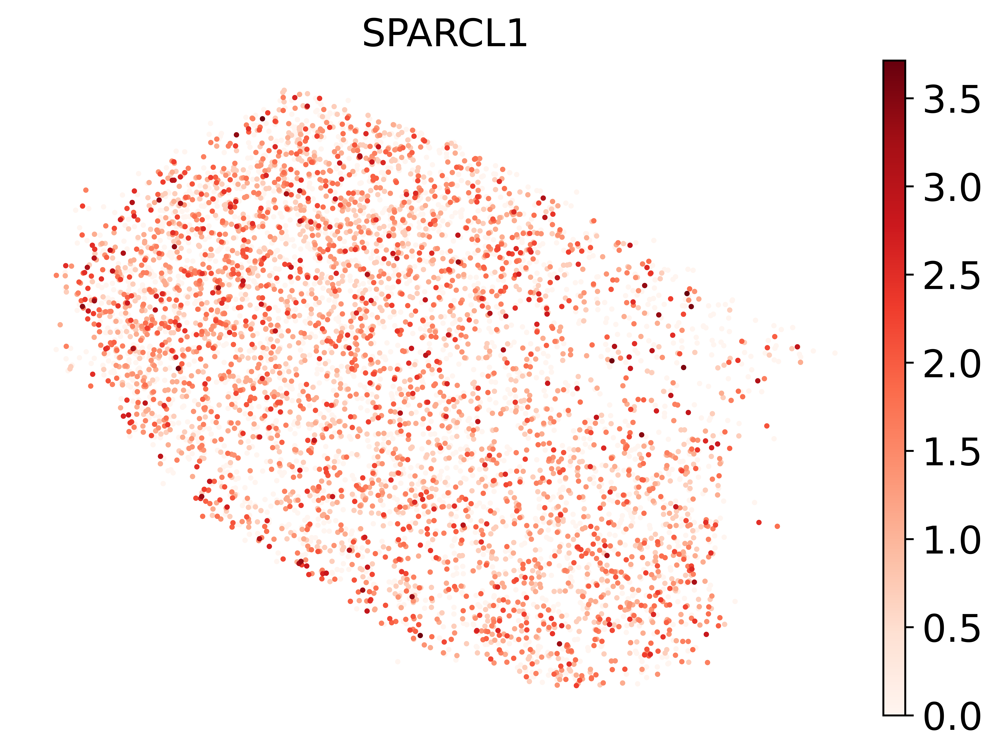

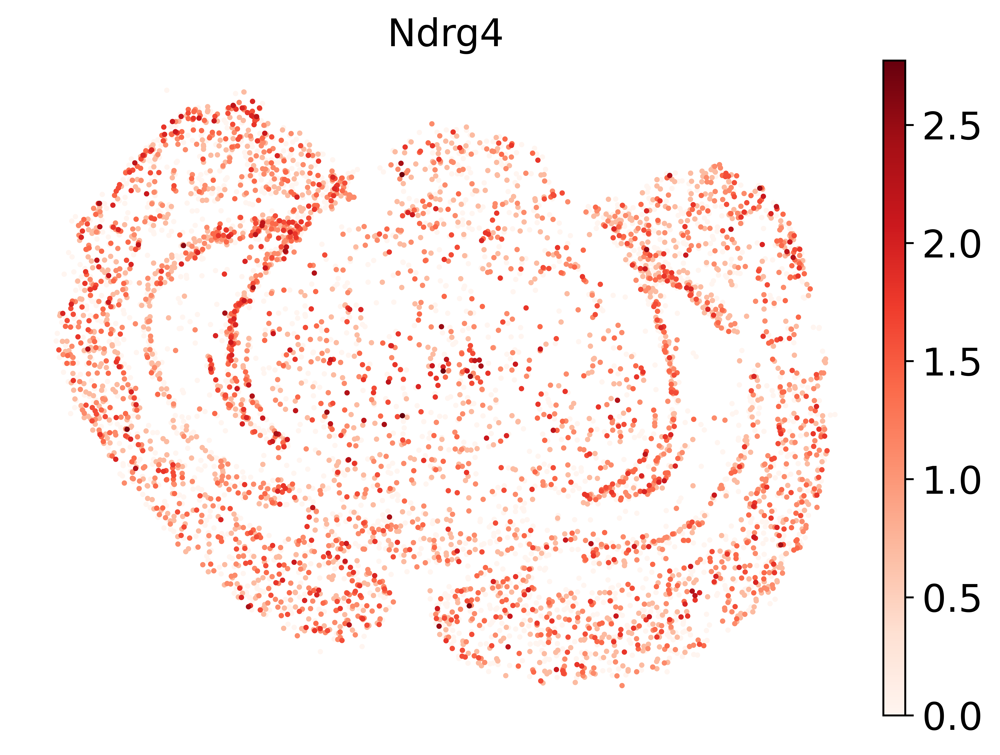

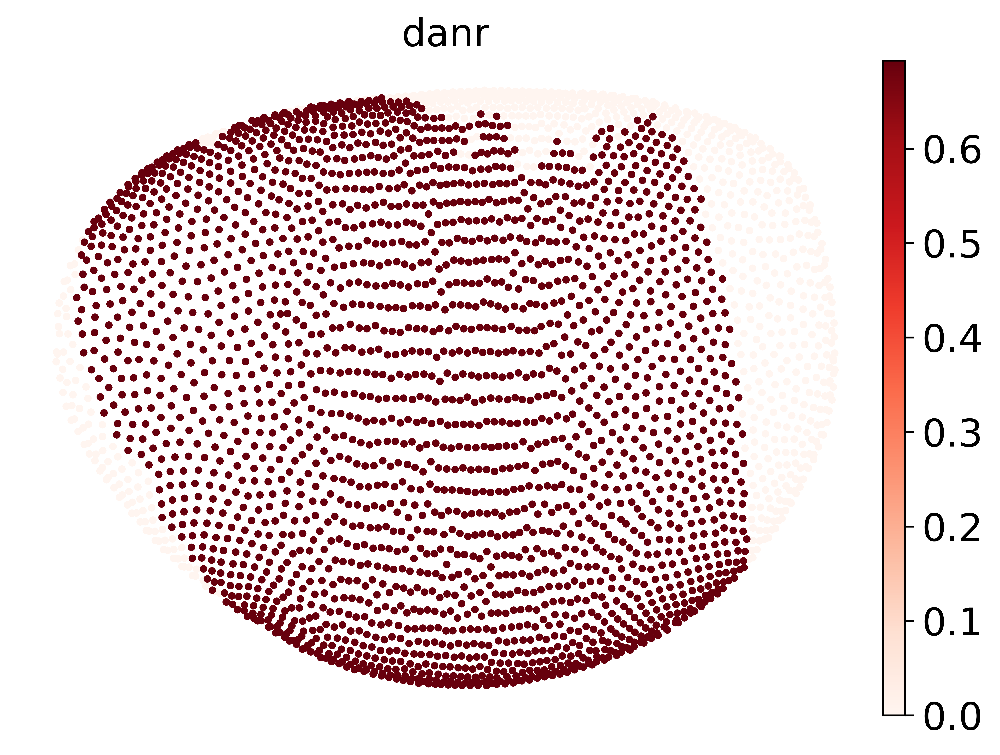

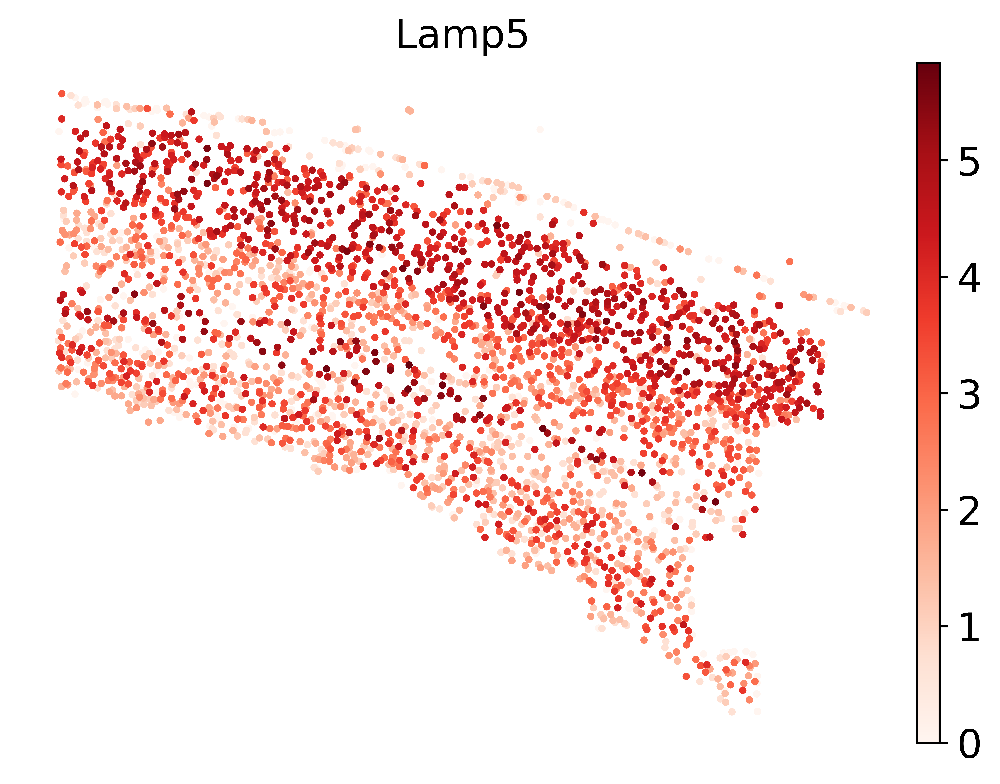

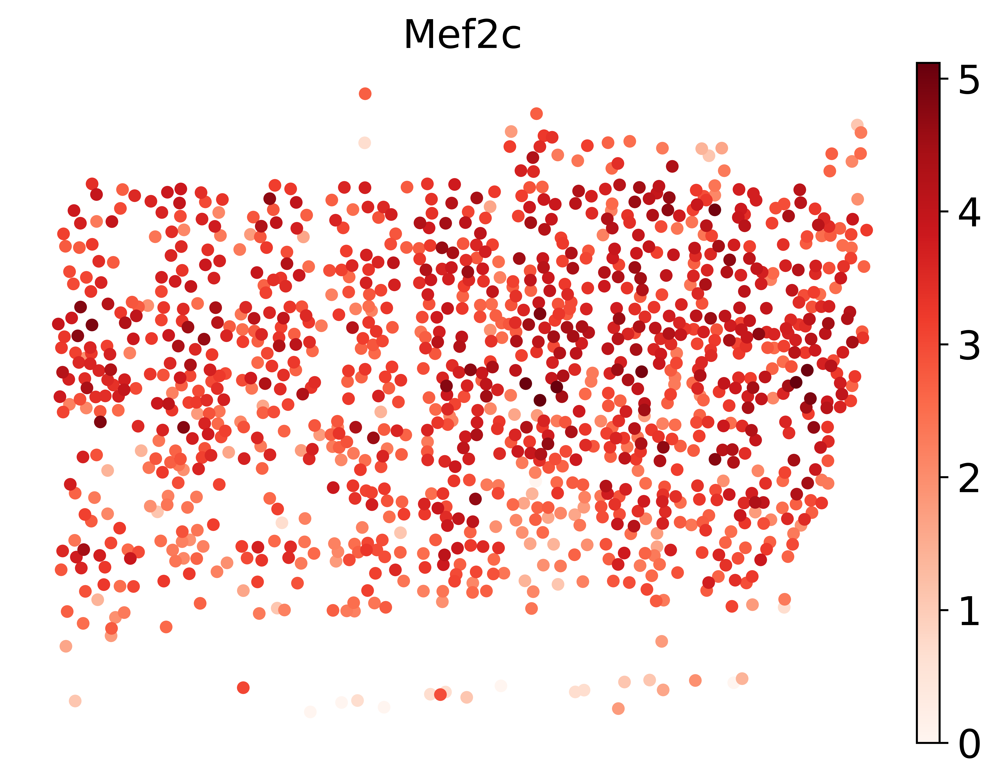

In [20]:
for d in [3, 9, 11, 12, 13, 14, 15, 17]:
    
    dataset_name = "Dataset"+str(d)

    adata = load_spatial_data("DataUpload/"+dataset_name+"/Spatial_count.txt",
                             "DataUpload/"+dataset_name+"/Locations.txt")
    
    adata.X = np.log1p(adata.X)
    
    if dataset_name == "Dataset14":
        adata.obsm["spatial"] = adata.obsm["spatial"][:,np.array([0,2])]

    max_gene = adata.var_names[np.where(np.sum(adata.X, axis=0) == np.sum(adata.X, axis=0).max())[0][0]]
    sc.set_figure_params(vector_friendly=True, dpi=500, figsize=(7,5), fontsize=16)
    sc.pl.embedding(adata, "spatial", color=max_gene, cmap="Reds", show=False)
    plt.axis('off')
    plt.savefig(f"plots/scpi_datasets/spatial_max_gene_{dataset_name}_{max_gene}.pdf", bbox_inches="tight", dpi=300)